<a href="https://colab.research.google.com/github/IsraelAbebe/Cats-and-Dogs-classification/blob/master/Cats_and_Dogs_TensorBoard_Example.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Download Dataset And Unzip

In [1]:
!wget  https://s3.amazonaws.com/content.udacity-data.com/nd089/Cat_Dog_data.zip 
!unzip Cat_Dog_data.zip 
# !rm -r  Cat_Dog_data/
# !rm -r __MACOSX/
# !rm -r runs/
# !rm -r runs.zip

--2020-01-22 21:24:55--  https://s3.amazonaws.com/content.udacity-data.com/nd089/Cat_Dog_data.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.16.46
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.16.46|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 580495262 (554M) [application/zip]
Saving to: ‘Cat_Dog_data.zip’

Cat_Dog_data.zip    100%[===================>] 553.60M  80.2MB/s    in 6.9s    

2020-01-22 21:25:03 (80.7 MB/s) - ‘Cat_Dog_data.zip’ saved [580495262/580495262]

Archive:  Cat_Dog_data.zip
   creating: Cat_Dog_data/
  inflating: Cat_Dog_data/.DS_Store  
   creating: __MACOSX/
   creating: __MACOSX/Cat_Dog_data/
  inflating: __MACOSX/Cat_Dog_data/._.DS_Store  
   creating: Cat_Dog_data/test/
   creating: Cat_Dog_data/test/cat/
  inflating: Cat_Dog_data/test/cat/cat.7660.jpg  
   creating: __MACOSX/Cat_Dog_data/test/
   creating: __MACOSX/Cat_Dog_data/test/cat/
  inflating: __MACOSX/Cat_Dog_data/test/cat/._cat.7660.jpg  
  inflati

## Defining the Dataloader

In [0]:
import os
import glob
from PIL import Image
from torchvision import transforms
from torch.utils.data import DataLoader,Dataset

In [0]:
class CustomDataset(Dataset):
    def __init__(self,path,transform=None):
        self.classes = os.listdir(path)
        self.classes = [i for i in self.classes if not i.startswith('.')]
        self.file_list = [os.listdir(path+'/'+i) for i in self.classes]

        self.transform = transform

        files = []
        for i, className in enumerate(self.classes):
            for fileName in self.file_list[i]:
                files.append([i, className, path+'/'+className+'/'+fileName])
        self.file_list = files
        files = None

    def __len__(self):
        return len(self.file_list)

    def __getitem__(self, idx):
        fileName = self.file_list[idx][2]
        classCategory = self.file_list[idx][0]
        im = Image.open(fileName)
        if self.transform:
            im = self.transform(im)
        return im, classCategory

## Model definations

In [0]:
import torch
from torchvision import transforms
import torch.nn as nn
import torch.nn.functional as F

class CNN(nn.Module):
    def __init__(self):
        super(CNN,self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3,out_channels=64,kernel_size=3)
        self.conv2 = nn.Conv2d(in_channels=64,out_channels=64,kernel_size=3)
        self.fc1 = nn.Linear(in_features = 14*14*64,out_features = 64)
        self.fc2 = nn.Linear(in_features = 64,out_features = 2)

        self.drop_layer = nn.Dropout(p=0.2)

    def forward(self,x):
        x = F.max_pool2d(F.relu(self.conv1(x)),2)
        x = F.max_pool2d(F.relu(self.conv2(x)),2)

        x = x.view(-1,14*14*64)

        x = F.relu(self.fc1(x))
        x = self.fc2(x)

        return x



class CNN_ONE(nn.Module):
    def __init__(self):
        super(CNN_ONE,self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3,out_channels=32,kernel_size=3)
        self.conv2 = nn.Conv2d(in_channels=32,out_channels=64,kernel_size=3)
        self.conv3 = nn.Conv2d(in_channels=64,out_channels=64,kernel_size=3)
        self.conv4 = nn.Conv2d(in_channels=64,out_channels=64,kernel_size=3)
        self.fc1 = nn.Linear(in_features = 13*13*64,out_features = 128)
        self.fc2 = nn.Linear(in_features = 128,out_features = 64)
        self.fc_out = nn.Linear(in_features = 64,out_features = 2)

        self.drop_layer = nn.Dropout(p=0.2)

    def forward(self,x):
        x = F.relu(self.conv1(x))
        x = F.max_pool2d(F.relu(self.conv2(x)),2)
        x = F.relu(self.conv3(x))
        x = self.drop_layer(F.max_pool2d(F.relu(self.conv4(x)),2))
        
        x = x.view(-1,13*13*64)

        x = self.drop_layer(F.relu(self.fc1(x)))
        x = F.relu(self.fc2(x))
        x = self.fc_out(x)

        return x

# Main

In [0]:
import torch
import torchvision
from torchvision import transforms
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from skimage import io,transform

In [0]:
device  = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
image_size = (64, 64)
image_row_size = image_size[0] * image_size[1] * 3

train_transform = transforms.Compose([
                                transforms.RandomRotation(30),
                                transforms.RandomHorizontalFlip(),
                                transforms.RandomVerticalFlip(),
                                transforms.Resize(image_size), 
                                transforms.ToTensor(), 
                                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

test_transform = transforms.Compose([transforms.Resize(image_size), 
                                transforms.ToTensor(), 
                                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])






criterion = nn.CrossEntropyLoss()

In [0]:
train_data = CustomDataset('Cat_Dog_data/'+'train/',  transform=train_transform)
test_data = CustomDataset('Cat_Dog_data/'+'test/',  transform=test_transform)


trainloader = torch.utils.data.DataLoader(train_data, batch_size=64,shuffle=True, num_workers=4)
testloader = torch.utils.data.DataLoader(test_data, batch_size=64,shuffle=True, num_workers=4)

# TO VISUALIZE THE DATA
vis_transform = transforms.Compose([transforms.Resize(image_size), transforms.ToTensor()])
trainset = torchvision.datasets.ImageFolder('Cat_Dog_data/train/')
vis_data = CustomDataset('Cat_Dog_data/'+'train/',  transform=vis_transform)
vis_loader = torch.utils.data.DataLoader(vis_data, batch_size=64,shuffle=True, num_workers=2)

In [0]:
%load_ext tensorboard
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
import numpy as np

import torch
import torchvision
import torchvision.transforms as transforms

In [0]:
classes = ('Dog','Cat')
def matplotlib_imshow(img, one_channel=False):
    if one_channel:
        img = img.mean(dim=0)
    img = img / 2 + 0.5     # unnormalize
    npimg = img.cpu().numpy()
    if one_channel:
        plt.imshow(npimg, cmap="Greys")
    else:
        plt.imshow(np.transpose(npimg, (1, 2, 0)))

In [10]:
writer = SummaryWriter('runs/cats_and_dogs_experiment_1')

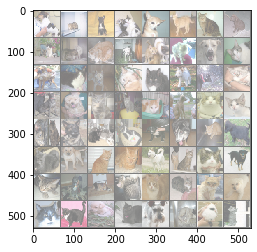

In [12]:
dataiter = iter(vis_loader)
images, labels = dataiter.next()

img_grid = torchvision.utils.make_grid(images)

matplotlib_imshow(img_grid, one_channel=False)

writer.add_image('cats_and_dogs', img_grid)

Showiung the images

In [13]:
%tensorboard --logdir=runs/

In [0]:
# def select_n_random(data, labels, n=100):
#     '''
#     Selects n random datapoints and their corresponding labels from a dataset
#     '''
#     assert len(data) == len(labels)

#     perm = torch.randperm(len(data))
#     return data[perm][:n], labels[perm][:n]

# images, labels = select_n_random(trainset.data, trainset.targets)

class_labels = [classes[lab] for lab in labels]


features = images.view(-1, 64 * 64 * 3)
writer.add_embedding(features,
                    metadata=class_labels,
                    label_img=images)
writer.close()

In [15]:
%tensorboard --logdir=runs/

Reusing TensorBoard on port 6006 (pid 232), started 0:00:16 ago. (Use '!kill 232' to kill it.)

# Models

In [0]:
# model1 = CNN()
model2 = CNN_ONE()

In [0]:
writer.add_graph(model2, images)
writer.close()

In [18]:
%tensorboard --logdir=runs/

Reusing TensorBoard on port 6006 (pid 232), started 0:00:33 ago. (Use '!kill 232' to kill it.)

In [0]:
def images_to_probs(net, images):
    '''
    Generates predictions and corresponding probabilities from a trained
    network and a list of images
    '''
    output = net(images)
    # convert output probabilities to predicted class
    _, preds_tensor = torch.max(output, 1)
    preds = np.squeeze(preds_tensor.cpu().numpy())
    return preds, [F.softmax(el, dim=0)[i].item() for i, el in zip(preds, output)]


def plot_classes_preds(net, images, labels):
    '''
    Generates matplotlib Figure using a trained network, along with images
    and labels from a batch, that shows the network's top prediction along
    with its probability, alongside the actual label, coloring this
    information based on whether the prediction was correct or not.
    Uses the "images_to_probs" function.
    '''
    preds, probs = images_to_probs(net, images)
    # plot the images in the batch, along with predicted and true labels
    fig = plt.figure(figsize=(12, 48))
    for idx in np.arange(4):
        ax = fig.add_subplot(1, 4, idx+1, xticks=[], yticks=[])
        matplotlib_imshow(images[idx], one_channel=True)
        ax.set_title("{0}, {1:.1f}%\n(label: {2})".format(
            classes[preds[idx]],
            probs[idx] * 100.0,
            classes[labels[idx]]),
                    color=("green" if preds[idx]==labels[idx].item() else "red"))
    return fig

# Model Training

In [0]:
optimizer = optim.Adam(model2.parameters(), lr=0.001)

In [0]:
import torch
from torchvision import transforms
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F



class Trainer():
    def __init__(self,model,path='Cat_Dog_data/'):
        self.device  = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.image_size = (64, 64)
        self.image_row_size = self.image_size[0] * self.image_size[1] * 3

        self.train_transform = transforms.Compose([
                                transforms.RandomRotation(30),
                                transforms.RandomHorizontalFlip(),
                                transforms.RandomVerticalFlip(),
                                transforms.Resize(self.image_size), 
                                transforms.ToTensor(), 
                                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

        self.test_transform = transforms.Compose([transforms.Resize(self.image_size), 
                                transforms.ToTensor(), 
                                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

        self.path = path 
        self.criterion = nn.CrossEntropyLoss()
        

        self.net = model
        self.net.to(self.device)

    def get_loader(self,path,batch_size = 64):
        train_data = CustomDataset(path+'train/',  transform=self.train_transform)
        test_data = CustomDataset(path+'test/',  transform=self.test_transform)

        trainloader = torch.utils.data.DataLoader(train_data, batch_size=batch_size,shuffle=True, num_workers=4)
        testloader = torch.utils.data.DataLoader(test_data, batch_size=batch_size,shuffle=False, num_workers=4)


        return trainloader,testloader
    
    def train(self,i,lr=0.001,batch_size=64):
        train_loader,_ = self.get_loader(self.path,batch_size=batch_size)


        optimizer = optim.Adam(self.net.parameters(), lr=lr)

        self.net.train()
        running_loss = []
        for batch_idx, (data, target) in enumerate(train_loader):
            data,target = data.to(self.device),target.to(self.device)
                
            optimizer.zero_grad()
            output = self.net(data)
            loss = self.criterion(output, target)
            loss.backward()
            optimizer.step()

            running_loss.append(loss.item())
            if batch_idx % 100 == 0:
                print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(i, batch_idx * len(data),
                len(train_loader.dataset),100. * batch_idx / len(train_loader), loss.item()))
        print('Avarage training loss',sum(running_loss)/len(running_loss),i)
        writer.add_scalar('training loss',sum(running_loss)/len(running_loss),i)
            
    def test(self,i):
        _,test_loader = self.get_loader(self.path)
        self.net.eval()

        accuracy_list = []
        test_loss = 0
        correct = 0
        for data, target in test_loader:
            data,target = data.to(self.device),target.to(self.device)
            output = self.net(data)
            test_loss += self.criterion(output, target).item()                                                              
            pred = output.data.max(1, keepdim=True)[1]                                                                
            correct += pred.eq(target.data.view_as(pred)).cpu().sum().item()
            writer.add_figure('predictions vs. actuals',
                            plot_classes_preds(self.net, data, target),
                            global_step= i)

        test_loss /= len(test_loader.dataset)
        accuracy = 100. * correct / len(test_loader.dataset)
        accuracy_list.append(accuracy)
        print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(test_loss, correct, len(test_loader.dataset),accuracy))
        writer.add_scalar('test loss',test_loss,i)
        


In [22]:
model2 = CNN_ONE()
# model2.load_state_dict(torch.load('cats_and_dogs_90_.h5'))
trainer = Trainer(model2)

epoches = 10
for i in range(epoches):
    trainer.train(i)
    trainer.test(i)

Train Epoch: 0 [0/22500 (0%)]	Loss: 0.693897
Train Epoch: 0 [6400/22500 (28%)]	Loss: 0.645707
Train Epoch: 0 [12800/22500 (57%)]	Loss: 0.692863
Train Epoch: 0 [19200/22500 (85%)]	Loss: 0.603304
Avarage training loss 0.6505589387802915 0

Test set: Average loss: 0.0106, Accuracy: 1504/2500 (60%)

Train Epoch: 1 [0/22500 (0%)]	Loss: 0.706494
Train Epoch: 1 [6400/22500 (28%)]	Loss: 0.606843
Train Epoch: 1 [12800/22500 (57%)]	Loss: 0.493386
Train Epoch: 1 [19200/22500 (85%)]	Loss: 0.622754
Avarage training loss 0.5733098217540167 1

Test set: Average loss: 0.0088, Accuracy: 1803/2500 (72%)

Train Epoch: 2 [0/22500 (0%)]	Loss: 0.527880
Train Epoch: 2 [6400/22500 (28%)]	Loss: 0.577306
Train Epoch: 2 [12800/22500 (57%)]	Loss: 0.610834
Train Epoch: 2 [19200/22500 (85%)]	Loss: 0.454534
Avarage training loss 0.5291165006770329 2

Test set: Average loss: 0.0081, Accuracy: 1878/2500 (75%)

Train Epoch: 3 [0/22500 (0%)]	Loss: 0.478449
Train Epoch: 3 [6400/22500 (28%)]	Loss: 0.568943
Train Epoch: 3 

In [0]:
class_probs = []
class_preds = []
with torch.no_grad():
    for batch_idx, (data, target) in enumerate(trainloader):
        images, labels = data.to(device),target.to(device)
        output = model2(images)
        class_probs_batch = [F.softmax(el, dim=0) for el in output]
        _, class_preds_batch = torch.max(output, 1)

        class_probs.append(class_probs_batch)
        class_preds.append(class_preds_batch)

test_probs = torch.cat([torch.stack(batch) for batch in class_probs])
test_preds = torch.cat(class_preds)

def add_pr_curve_tensorboard(class_index, test_probs, test_preds, global_step=0):
    '''for epoch in range(epochs):
            
    Takes in a "class_index" from 0 to 9 and plots the corresponding
    precision-recall curve
    '''
    tensorboard_preds = test_preds == class_index
    tensorboard_probs = test_probs[:, class_index]

    writer.add_pr_curve(classes[class_index],
                        tensorboard_preds,
                        tensorboard_probs,
                        global_step=global_step)
    writer.close()

# plot all the pr cisraelurves
for i in range(len(classes)):
    add_pr_curve_tensorboard(i, test_probs, test_preds)

In [24]:
%tensorboard --logdir=runs/

Reusing TensorBoard on port 6006 (pid 232), started 0:21:34 ago. (Use '!kill 232' to kill it.)

# Zip Download Model And Tensorboard History

In [25]:
!zip -r runs.zip runs/

  adding: runs/ (stored 0%)
  adding: runs/cats_and_dogs_experiment_1/ (stored 0%)
  adding: runs/cats_and_dogs_experiment_1/projector_config.pbtxt (deflated 48%)
  adding: runs/cats_and_dogs_experiment_1/00000/ (stored 0%)
  adding: runs/cats_and_dogs_experiment_1/00000/default/ (stored 0%)
  adding: runs/cats_and_dogs_experiment_1/00000/default/sprite.png (deflated 0%)
  adding: runs/cats_and_dogs_experiment_1/00000/default/tensors.tsv (deflated 90%)
  adding: runs/cats_and_dogs_experiment_1/00000/default/metadata.tsv (deflated 87%)
  adding: runs/cats_and_dogs_experiment_1/events.out.tfevents.1579728694.5b52123248f4.119.2 (deflated 34%)
  adding: runs/cats_and_dogs_experiment_1/events.out.tfevents.1579729779.5b52123248f4.119.3 (deflated 56%)
  adding: runs/cats_and_dogs_experiment_1/events.out.tfevents.1579728521.5b52123248f4.119.0 (deflated 0%)
  adding: runs/cats_and_dogs_experiment_1/events.out.tfevents.1579728566.5b52123248f4.119.1 (deflated 86%)


In [0]:
torch.save(model2.state_dict(),'cats_and_dogs_90_.h5')